# CE 5900 - AI4CCEE Mini-Project 1

This project aims to analyze crash data on Iowa's multilane arterials, identify hotspots, and develop a predictive model to forecast fatal crashes using historical and environmental factors.

## Dataset

1. **Crash Data**: The crash data is obtained from **Fatality Analysis Reporting System (FARS)** data from 2016 to 2022. The data is saved in folders named after the year of the data and accident.CSV file is used to obtain the crash data and the fatalities associated with them.

2. **Multilane Arterial Road Data**: Multilane arterial roads with lanes 4-9 on primary and secondary highways is downloaded from **Overpass Turbo** by using the following query. 

// @name arterial road

[out:json][timeout:25];

area[name="Iowa"]->.searchArea;

// Find arterial roads (highway=primary or highway=secondary) with multiple lanes

(

  way["highway"~"primary|secondary"]["lanes"~"[4-9]"](area.searchArea);

);

// Output the result

out body;

>;

out skel qt;


**Merging Accident Data CSV Files from Folders (2016-2022) and filters the data by Iowa State**

This Python script reads multiple CSV files from subfolders (each named by year) within the main folder `FARS_Data`, processes them into individual dataframes, and then merges these dataframes into a single one. The data files contain detailed accident information for the years 2016 through 2022, with each subfolder containing an `accident.CSV` file. The final output is a combined dataframe that consolidates all years into a single dataset.

In [186]:
import os
import pandas as pd

# Folder containing the subfolders with accident data
base_folder = r'C:\Users\mrevanth\OneDrive - Iowa State University\Desktop\Miniproject 1\FARS_Data'

# List to store the dataframes for each year
dataframes = []

# Loop over the folders for each year (2016 to 2022)
for year in range(2016, 2023):
    year_folder = os.path.join(base_folder, str(year))
    file_path = os.path.join(year_folder, 'accident.CSV')
    
    # Read the CSV file for the current year
    if os.path.exists(file_path):
        try:
            df = pd.read_csv(file_path, encoding='ISO-8859-1', low_memory=False)  # Specify ISO-8859-1 encoding
            dataframes.append(df)
        except Exception as e:
            print(f"Error reading file {file_path}: {e}")
    else:
        print(f"File not found: {file_path}")

# Concatenate all dataframes into one
if dataframes:
    merged_df = pd.concat(dataframes, ignore_index=True)
    
    # Display the merged dataframe
    #print(merged_df.head())
else:
    print("No files were found or read successfully.")


# Filter the dataframe for rows where STATENAME is 'Iowa'
iowa_df = merged_df[merged_df['STATENAME'] == 'Iowa']

# Display the filtered dataframe
print(iowa_df.head())

       STATE STATENAME  ST_CASE  VE_TOTAL  VE_FORMS  PVH_INVL  PEDS  PERSONS  \
13425     19      Iowa   190001         2         2         0     0        3   
13426     19      Iowa   190002         1         1         0     0        1   
13427     19      Iowa   190003         1         1         0     0        1   
13428     19      Iowa   190004         1         1         0     0        2   
13429     19      Iowa   190005         2         2         0     0        3   

       PERMVIT  PERNOTMVIT  ...  HOSP_MN                        HOSP_MNNAME  \
13425        3           0  ...       88   Not Applicable (Not Transported)   
13426        1           0  ...       99  Unknown EMS Hospital Arrival Time   
13427        1           0  ...       88   Not Applicable (Not Transported)   
13428        2           0  ...       88   Not Applicable (Not Transported)   
13429        3           0  ...       99  Unknown EMS Hospital Arrival Time   

       CF1 CF1NAME  CF2  CF2NAME  CF3 CF3NAM

**Converting Iowa Crash data into a shapefile**

       STATE STATENAME  ST_CASE  VE_TOTAL  VE_FORMS  PVH_INVL  PEDS  PERSONS  \
13425     19      Iowa   190001         2         2         0     0        3   
13426     19      Iowa   190002         1         1         0     0        1   
13427     19      Iowa   190003         1         1         0     0        1   
13428     19      Iowa   190004         1         1         0     0        2   
13429     19      Iowa   190005         2         2         0     0        3   

       PERMVIT  PERNOTMVIT  ...                        HOSP_MNNAME  CF1  \
13425        3           0  ...   Not Applicable (Not Transported)  0.0   
13426        1           0  ...  Unknown EMS Hospital Arrival Time  0.0   
13427        1           0  ...   Not Applicable (Not Transported)  0.0   
13428        2           0  ...   Not Applicable (Not Transported)  0.0   
13429        3           0  ...  Unknown EMS Hospital Arrival Time  0.0   

       CF1NAME  CF2  CF2NAME  CF3  CF3NAME FATALS  DRUNK_DR  \
13425

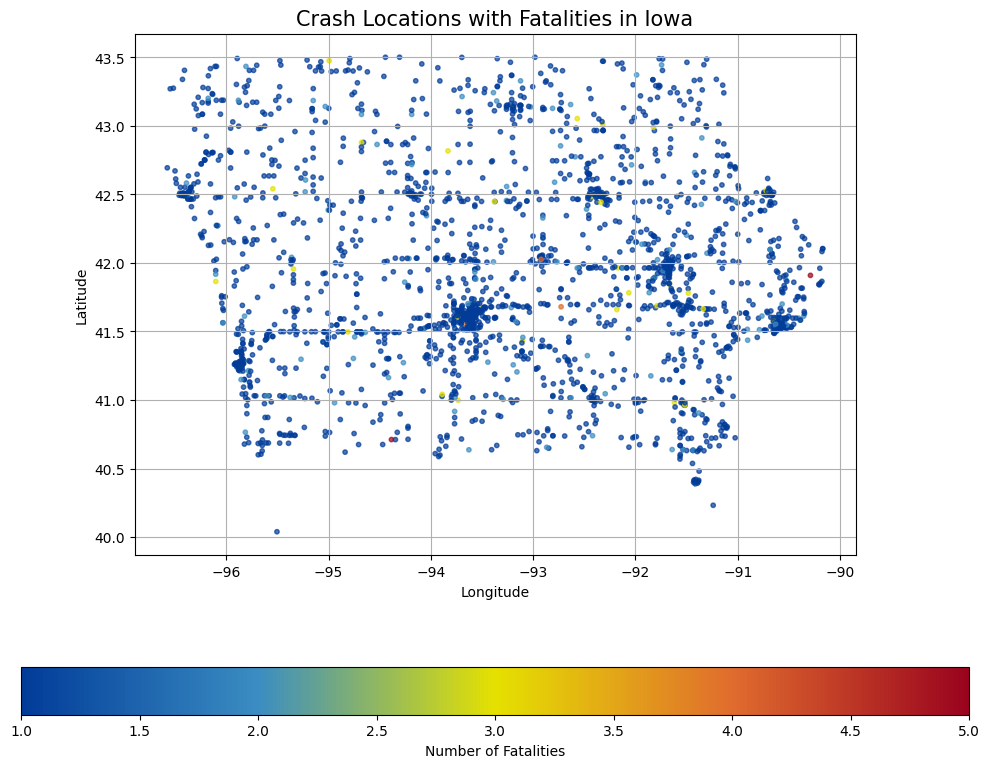

In [188]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# Define Batlow-like colors (simplified from original Batlow palette)
batlow_colors = [
    "#013C99",  # Dark blue
    "#3B8DC2",  # Light blue
    "#E5E100",  # Yellow
    "#E06C2E",  # Orange
    "#9A031E"   # Red
]

# Create a custom Batlow colormap
batlow_cmap = LinearSegmentedColormap.from_list("batlow", batlow_colors, N=256)

def create_crash_gdf(iowa_df):
    # Ensure we're working with a copy to avoid SettingWithCopyWarning
    iowa_df = iowa_df.copy()

    # Step 1: Check if necessary columns are available
    required_columns = {'LATITUDE', 'LONGITUD', 'FATALS', 
                        'CITYNAME', 'RD_OWNERNAME', 'LGT_CONDNAME', 
                        'WEATHER1NAME', 'DRUNK_DR'}
    if not required_columns.issubset(iowa_df.columns):
        raise ValueError(f"The required columns {required_columns} are not present in the dataframe.")

    # Step 2: Create geometry using .loc to avoid warnings
    iowa_df.loc[:, 'geometry'] = iowa_df.apply(
        lambda row: Point(row['LONGITUD'], row['LATITUDE']), axis=1
    )

    # Step 3: Convert to a GeoDataFrame with all the attributes
    crash_gdf = gpd.GeoDataFrame(iowa_df, geometry='geometry')

    # Step 4: Set the CRS (assuming WGS84 - EPSG:4326)
    crash_gdf.set_crs(epsg=4326, inplace=True)

    # Display the first few rows for verification
    print(crash_gdf.head())

    return crash_gdf

def plot_crash_shapefile(crash_gdf):
    # Step 1: Create a figure and axis
    fig, ax = plt.subplots(figsize=(10, 8))

    # Step 2: Plot the points using the custom Batlow colormap
    crash_gdf.plot(
        ax=ax,
        column='FATALS',  # Use 'FATALS' to color the points
        cmap=batlow_cmap,  # Custom Batlow colormap
        legend=True,
        legend_kwds={'label': "Number of Fatalities", 'orientation': "horizontal"},
        markersize=10,
        alpha=0.7  # Transparency for better visualization
    )

    # Step 3: Customize the plot
    ax.set_title("Crash Locations with Fatalities in Iowa", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

    # Step 4: Remove the redundant plt.legend() call to avoid warning
    # Step 5: Display the plot
    plt.grid(True)  # Optional: Add grid lines for reference
    plt.tight_layout()  # Adjust layout to fit everything
    plt.show()

# Assuming iowa_df is available and contains all the necessary columns
crash_gdf = create_crash_gdf(iowa_df)

# Plot the crash points with the Batlow colormap
plot_crash_shapefile(crash_gdf)


## Plotting Iowa crash locations

**Interactive Map of Crash locations in Iowa**

This Python code creates a minimally interactive map using the folium library. It reads the latitude and longitude values from the iowa_df dataframe and displays each accident location as a blue dot on the map. The map is zoomed to the extent of the data to ensure all accident locations are visible.

In [189]:
import folium
from IPython.display import display
import matplotlib.colors as mcolors

# Define a list of colors to use for each year
colors = list(mcolors.TABLEAU_COLORS.values())

# Check if the 'LATITUDE', 'LONGITUD', and 'YEAR' columns exist in the dataframe
if {'LATITUDE', 'LONGITUD', 'YEAR'}.issubset(iowa_df.columns):
    # Create a Folium map, but do not specify the center or zoom level yet
    accident_map = folium.Map(zoom_control=False)

    # Get unique years and assign a color to each year
    unique_years = iowa_df['YEAR'].unique()
    color_dict = {year: colors[i % len(colors)] for i, year in enumerate(unique_years)}

    # Add circle markers (dots) for each accident location in the dataframe with different colors for each year
    for _, row in iowa_df.iterrows():
        folium.CircleMarker(
            location=[row['LATITUDE'], row['LONGITUD']],
            radius=3,  # Adjust the size of the dot
            color=color_dict[row['YEAR']],  # Color based on year
            fill=True,
            fill_color=color_dict[row['YEAR']],
            fill_opacity=0.7,
            popup=f"Year: {row['YEAR']}, Location: {row['LATITUDE']}, {row['LONGITUD']}"
        ).add_to(accident_map)

    # Fit the map to the bounds of the data
    bounds = [[iowa_df['LATITUDE'].min(), iowa_df['LONGITUD'].min()],
              [iowa_df['LATITUDE'].max(), iowa_df['LONGITUD'].max()]]
    accident_map.fit_bounds(bounds)

    # Create a custom legend (HTML)
    legend_html = """
     <div style="position: fixed; 
                 bottom: 50px; left: 50px; width: 200px; height: 150px; 
                 border:2px solid grey; z-index:9999; font-size:14px;
                 background-color:white; padding: 10px;">
     <strong>Year Legend</strong><br>
     """
    for year, color in color_dict.items():
        legend_html += f'<i style="background:{color};width:10px;height:10px;display:inline-block;"></i> {year}<br>'
    
    legend_html += '</div>'
    
    # Add the legend to the map
    accident_map.get_root().html.add_child(folium.Element(legend_html))

    # Save the map as an HTML file
    accident_map.save('iowa_accidents_map_with_legend.html')

    # Display the map inline in the notebook
    display(accident_map)
else:
    print("The dataframe does not contain required columns.")


**Static Plot of Iowa crash locations using Matplotlib**

This Python code uses matplotlib to create a static scatter plot of the accident locations from the iowa_df dataframe. Unlike folium, this approach creates a fully static, non-interactive map where accident locations are plotted as blue dots based on their latitude and longitude.

Iowa Boundary CRS: EPSG:26915


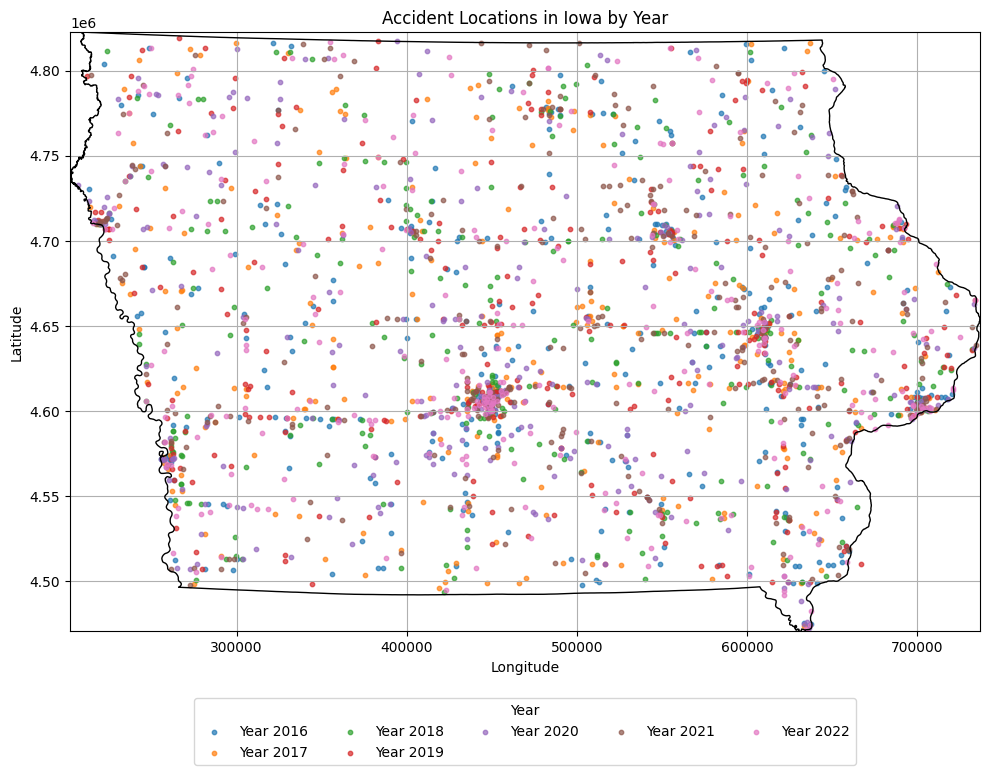

In [190]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from shapely.geometry import Point
import pandas as pd

# Load the Iowa state boundary shapefile
iowa_boundary_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/iowa_border/iowa_border.shp')

# Check the CRS of the Iowa boundary shapefile
print("Iowa Boundary CRS:", iowa_boundary_gdf.crs)

# Create a GeoDataFrame for crash data with the same CRS as the Iowa boundary
if {'LATITUDE', 'LONGITUD', 'YEAR'}.issubset(iowa_df.columns):

    # Create geometry for crash data using LATITUDE and LONGITUD
    geometry = [Point(xy) for xy in zip(iowa_df['LONGITUD'], iowa_df['LATITUDE'])]
    crash_gdf = gpd.GeoDataFrame(iowa_df, geometry=geometry)

    # Check if the crash data has a CRS, and set to EPSG:4326 if not present
    if crash_gdf.crs is None:
        crash_gdf.set_crs(epsg=4326, inplace=True)  # Assume WGS84 if no CRS is set

    # Reproject crash data to match the CRS of the Iowa boundary if necessary
    if crash_gdf.crs != iowa_boundary_gdf.crs:
        crash_gdf = crash_gdf.to_crs(iowa_boundary_gdf.crs)

    # Define a list of colors to use for each year
    colors = list(mcolors.TABLEAU_COLORS.values())

    # Get unique years and assign a color to each year
    unique_years = sorted(crash_gdf['YEAR'].unique())  # Ensure years are sorted
    color_dict = {year: colors[i % len(colors)] for i, year in enumerate(unique_years)}

    # Create a figure and axis for the plot
    fig, ax = plt.subplots(figsize=(10, 8))

    # Plot the Iowa state boundary
    iowa_boundary_gdf.boundary.plot(edgecolor='black', linewidth=1, ax=ax)

    # Loop through each year and plot the crash data
    for year in unique_years:
        year_data = crash_gdf[crash_gdf['YEAR'] == year]
        ax.scatter(year_data.geometry.x, year_data.geometry.y, 
                   s=10, color=color_dict[year], label=f"Year {year}", alpha=0.7)

    # Set axis limits to the boundary extent to ensure the plot is not distorted
    boundary_extent = iowa_boundary_gdf.total_bounds  # [minx, miny, maxx, maxy]
    ax.set_xlim(boundary_extent[0], boundary_extent[2])
    ax.set_ylim(boundary_extent[1], boundary_extent[3])

    # Set aspect ratio to be equal to avoid distortion
    ax.set_aspect('equal')

    # Add title, labels, and grid
    ax.set_title("Accident Locations in Iowa by Year")
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.grid(True)

    # Position the legend outside the plot, at the bottom
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=5, title="Year")

    # Show the plot
    plt.tight_layout()
    plt.show()

else:
    print("The dataframe does not contain required columns.")


**Animation of Crash data in Iowa**

The following script creates a gif file in the parent folder which demonstrates the animation of yearly variation in crash spots in Iowa.

Check the parent folder for output.

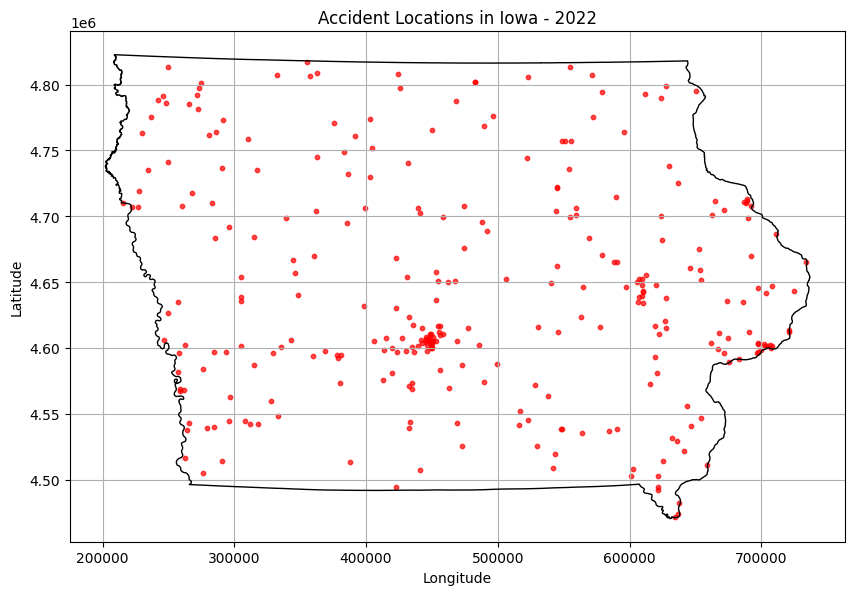

In [191]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point
from matplotlib.animation import FuncAnimation, PillowWriter

# Load the Iowa state boundary shapefile
iowa_boundary_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/iowa_border/iowa_border.shp')

# Create a GeoDataFrame for crash data using LATITUDE and LONGITUD
if {'LATITUDE', 'LONGITUD', 'YEAR'}.issubset(iowa_df.columns):

    # Create geometry for crash data
    geometry = [Point(xy) for xy in zip(iowa_df['LONGITUD'], iowa_df['LATITUDE'])]
    crash_gdf = gpd.GeoDataFrame(iowa_df, geometry=geometry)

    # Set CRS for the crash data if not already set
    if crash_gdf.crs is None:
        crash_gdf.set_crs(epsg=4326, inplace=True)  # Assume WGS84 if no CRS is set

    # Reproject crash data to match Iowa boundary CRS
    if crash_gdf.crs != iowa_boundary_gdf.crs:
        crash_gdf = crash_gdf.to_crs(iowa_boundary_gdf.crs)

    # Create the figure and axis for the plot
    fig, ax = plt.subplots(figsize=(10, 8))

    # Set fixed axis limits based on the Iowa boundary extent
    boundary_extent = iowa_boundary_gdf.total_bounds  # [minx, miny, maxx, maxy]
    ax.set_xlim(boundary_extent[0], boundary_extent[2])
    ax.set_ylim(boundary_extent[1], boundary_extent[3])

    # Set aspect ratio to be equal
    ax.set_aspect('equal')

    # Function to update the plot for each frame (year)
    def update(year):
        ax.clear()  # Clear the previous frame

        # Plot the Iowa boundary
        iowa_boundary_gdf.boundary.plot(edgecolor='black', linewidth=1, ax=ax)

        # Plot crashes for the current year
        year_data = crash_gdf[crash_gdf['YEAR'] == year]
        ax.scatter(year_data.geometry.x, year_data.geometry.y, 
                   s=10, color='red', alpha=0.7)

        # Add title and labels
        ax.set_title(f"Accident Locations in Iowa - {year}")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        ax.grid(True)

    # Create the animation using FuncAnimation
    ani = FuncAnimation(fig, update, frames=sorted(crash_gdf['YEAR'].unique()), repeat=False, interval=1000)

    # Save the animation as a GIF using PillowWriter
    writer = PillowWriter(fps=2)  # Adjust FPS if needed
    ani.save('iowa_crashes_animation.gif', writer=writer)

    # Show the animation
    plt.show()

else:
    print("The dataframe does not contain required columns.")


## Multilane Arterial Road geojson data and Analysis

Load the Multilane Arterial Roads JSON for interactive map.

In [192]:
import geopandas as gpd
import folium

# Load the shapefile containing the Iowa state boundary
iowa_boundary_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/iowa_border/iowa_border.shp')

# Load the JSON file containing multilane arterial roads
roads_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/export.geojson')

# Reproject both datasets to a common CRS (EPSG:4326 for Folium)
roads_gdf = roads_gdf.to_crs(epsg=4326)
iowa_boundary_gdf = iowa_boundary_gdf.to_crs(epsg=4326)

# Get the bounds of the Iowa boundary (min_x, min_y, max_x, max_y)
bounds = iowa_boundary_gdf.total_bounds

# Calculate the center of the Iowa boundary
center_x = (bounds[0] + bounds[2]) / 2
center_y = (bounds[1] + bounds[3]) / 2

# Create a Folium map centered on the Iowa boundary
roads_map = folium.Map(location=[center_y, center_x], zoom_start=7)

# Add the Iowa state boundary to the map with black outline and no fill
folium.GeoJson(
    iowa_boundary_gdf.geometry,
    name='Iowa Boundary',
    style_function=lambda x: {'color': 'black', 'weight': 3, 'fillOpacity': 0}
).add_to(roads_map)

# Add the multilane arterial roads to the map in red
for _, road in roads_gdf.iterrows():
    folium.GeoJson(
        road.geometry,
        style_function=lambda x: {'color': 'red', 'weight': 2}
    ).add_to(roads_map)

# Save the map as HTML and display it
roads_map.save('multilane_roads_with_iowa_boundary.html')
roads_map


Arterial roads static map

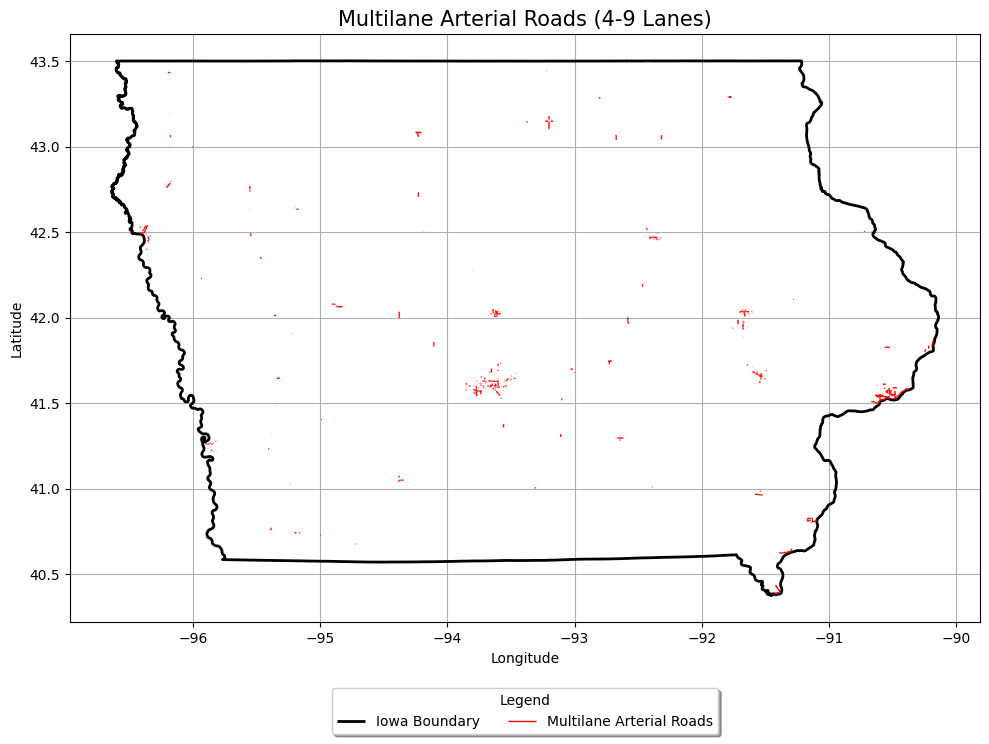

In [193]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load the shapefile containing the Iowa state boundary
iowa_boundary_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/iowa_border/iowa_border.shp')

# Load the JSON file containing multilane arterial roads
roads_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/export.geojson')

# Reproject both datasets to a common CRS (EPSG:4326 for consistency)
roads_gdf = roads_gdf.to_crs(epsg=4326)
iowa_boundary_gdf = iowa_boundary_gdf.to_crs(epsg=4326)

# Create a matplotlib figure and axis
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the Iowa boundary with no fill and black outline
iowa_boundary_gdf.boundary.plot(ax=ax, edgecolor='black', linewidth=2, label='Iowa Boundary')

# Plot the multilane arterial roads in red
roads_gdf.plot(ax=ax, color='red', linewidth=1, label='Multilane Arterial Roads')

# Set plot title and labels
ax.set_title("Multilane Arterial Roads (4-9 Lanes)", fontsize=15)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# Add a legend outside the plot area, at the bottom
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), fancybox=True, shadow=True, ncol=2, title="Legend")

# Display the plot
plt.grid(True)
plt.tight_layout()
plt.show()


Code for Number of lines in the shapefile.

In [194]:
line_count = roads_gdf.geometry.apply(lambda x: 1 if x.type in ['LineString', 'MultiLineString'] else 0).sum()
print(f'Number of lines in the polyline file: {line_count}')

Number of lines in the polyline file: 1315


C:\Users\mrevanth\AppData\Local\Temp\ipykernel_22116\2552697091.py:1: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  line_count = roads_gdf.geometry.apply(lambda x: 1 if x.type in ['LineString', 'MultiLineString'] else 0).sum()


# Data Analysis

**Crash and Fatality Data for various cities**

In [195]:
import pandas as pd

# Group by CITYNAME and count the number of crashes for each city
crash_count_per_city = iowa_df.groupby('CITYNAME').size()

# Group by CITYNAME and sum the number of fatalities (FATALS column) for each city
fatalities_per_city = iowa_df.groupby('CITYNAME')['FATALS'].sum()

# Create a new DataFrame combining the crash count and fatalities
crash_summary_df = pd.DataFrame({
    'Crash_Count': crash_count_per_city,
    'Number_of_Fatalities': fatalities_per_city
})

# Reset the index to make CITYNAME a column
crash_summary_df = crash_summary_df.reset_index()

# Sort the DataFrame by 'Crash_Count' in descending order
crash_summary_df = crash_summary_df.sort_values(by='Crash_Count', ascending=False)

# Display the resulting DataFrame
print(crash_summary_df)

           CITYNAME  Crash_Count  Number_of_Fatalities
109  NOT APPLICABLE         1523                  1689
40       DES MOINES          115                   126
36        DAVENPORT           58                    63
22     CEDAR RAPIDS           51                    55
138      SIOUX CITY           34                    37
..              ...          ...                   ...
65         GRINNELL            1                     1
63          GRANGER            1                     1
62   GRAND JUNCTION            1                     1
61     GILMORE CITY            1                     1
161       WINTERSET            1                     1

[162 rows x 3 columns]


The below code gives five cities with maximum number of fatalities.

In [196]:
import pandas as pd

# Group by CITYNAME and count the number of crashes for each city
crash_count_per_city = iowa_df.groupby('CITYNAME').size()

# Group by CITYNAME and sum the number of fatalities (FATALS column) for each city
fatalities_per_city = iowa_df.groupby('CITYNAME')['FATALS'].sum()

# Create a new DataFrame combining the crash count and fatalities
crash_summary_df = pd.DataFrame({
    'Crash_Count': crash_count_per_city,
    'Number_of_Fatalities': fatalities_per_city
})

# Reset the index to make CITYNAME a column
crash_summary_df = crash_summary_df.reset_index()

# Filter out the rows where CITYNAME is 'NOTAPPLICABLE'
crash_summary_filtered = crash_summary_df[crash_summary_df['CITYNAME'] != 'NOT APPLICABLE']

# Sort the DataFrame by 'Crash_Count' in descending order and get the top 5 cities
top_5_cities = crash_summary_filtered.sort_values(by='Crash_Count', ascending=False).head(5)

# Display the top 5 cities
print(top_5_cities)


         CITYNAME  Crash_Count  Number_of_Fatalities
40     DES MOINES          115                   126
36      DAVENPORT           58                    63
22   CEDAR RAPIDS           51                    55
138    SIOUX CITY           34                    37
150      WATERLOO           29                    32


Plotting the annual variation of fatalities in top five cities.

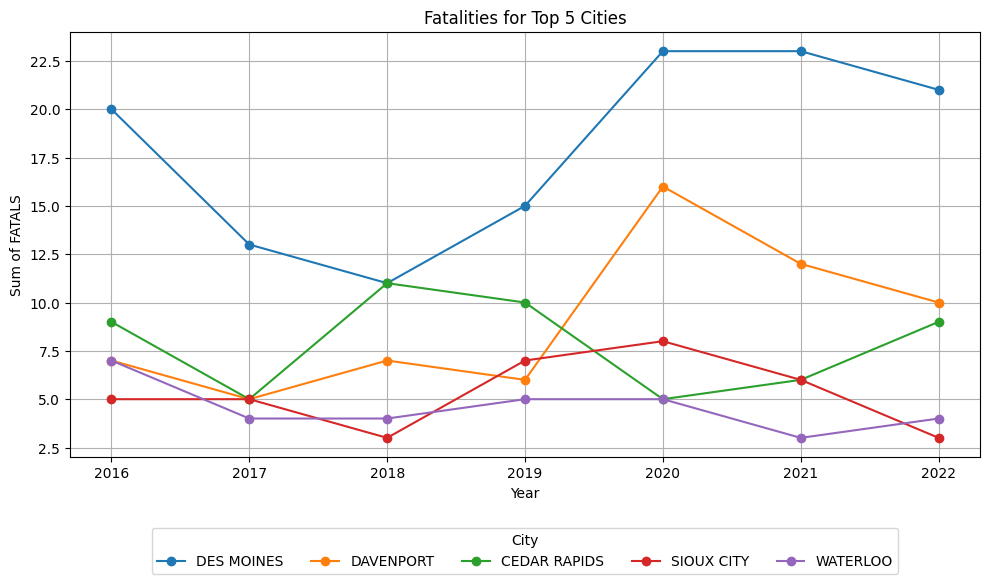

In [197]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming top_5_cities is already computed from the previous step

# Filter iowa_df to include only rows from the top 5 cities
top_5_city_names = top_5_cities['CITYNAME'].tolist()  # Get the list of top 5 city names
filtered_iowa_df = iowa_df[iowa_df['CITYNAME'].isin(top_5_city_names)]  # Filter the dataframe

# Group by CITYNAME and YEAR, and sum the FATALS for each year
fatalities_by_year = filtered_iowa_df.groupby(['CITYNAME', 'YEAR'])['FATALS'].sum().reset_index()

# Create a single plot for the top 5 cities
plt.figure(figsize=(10, 6))

# Plot a line graph for each city
for city in top_5_city_names:
    city_data = fatalities_by_year[fatalities_by_year['CITYNAME'] == city]
    plt.plot(city_data['YEAR'], city_data['FATALS'], label=city, marker='o')

# Add labels, title, and grid
plt.xlabel('Year')
plt.ylabel('Sum of FATALS')
plt.title('Fatalities for Top 5 Cities')
plt.grid(True)

# Move the legend to the bottom outside the plot
plt.legend(title="City", loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=5)

# Display the plot
plt.tight_layout()
plt.show()


**Plot to compare the variation in fatalities at different intersections for top 5 cities from 2016 to 2022.**

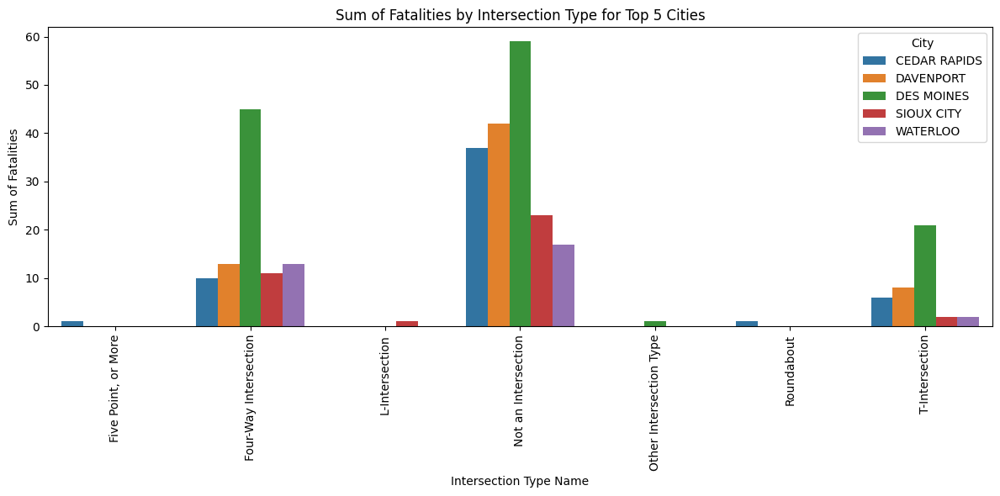

In [198]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming top_5_cities is already computed
top_5_city_names = top_5_cities['CITYNAME'].tolist()  # Get the list of top 5 city names

# Filter the DataFrame for the top 5 cities
filtered_df = iowa_df[iowa_df['CITYNAME'].isin(top_5_city_names)]

# Group by TYP_INTNAME and CITYNAME and sum the fatalities (FATALS)
fatalities_by_intersection = filtered_df.groupby(['TYP_INTNAME', 'CITYNAME'])['FATALS'].sum().reset_index()

# Set up the matplotlib figure
plt.figure(figsize=(12, 6))

# Create the bar plot without confidence intervals (error bars)
sns.barplot(data=fatalities_by_intersection, x='TYP_INTNAME', y='FATALS', hue='CITYNAME', errorbar=None)

# Customize the plot
plt.title('Sum of Fatalities by Intersection Type for Top 5 Cities')
plt.xlabel('Intersection Type Name')
plt.ylabel('Sum of Fatalities')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.legend(title='City')
plt.tight_layout()

# Show the plot
plt.show()


Plot the graph for various variables.

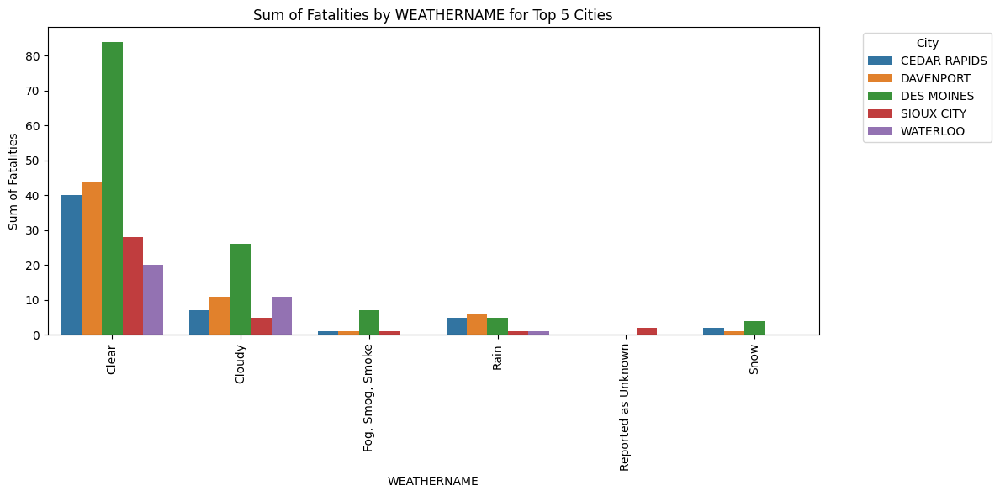

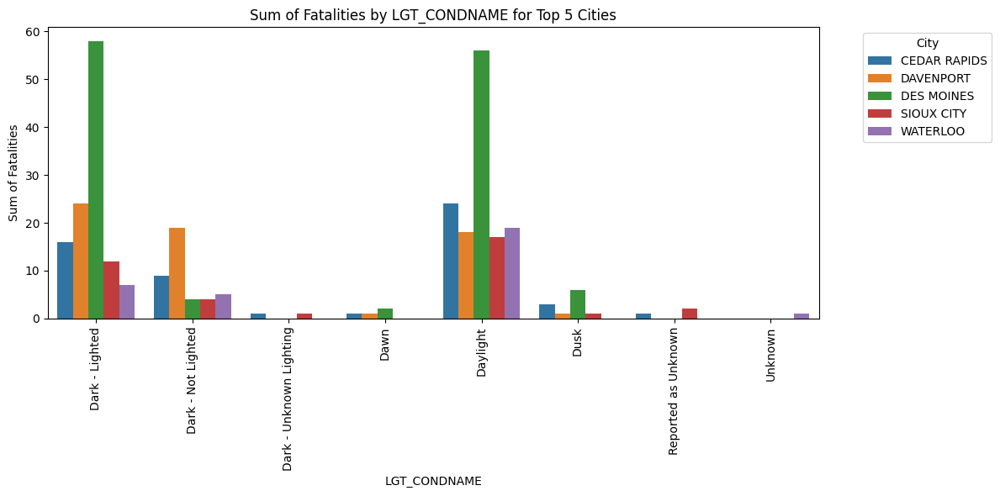

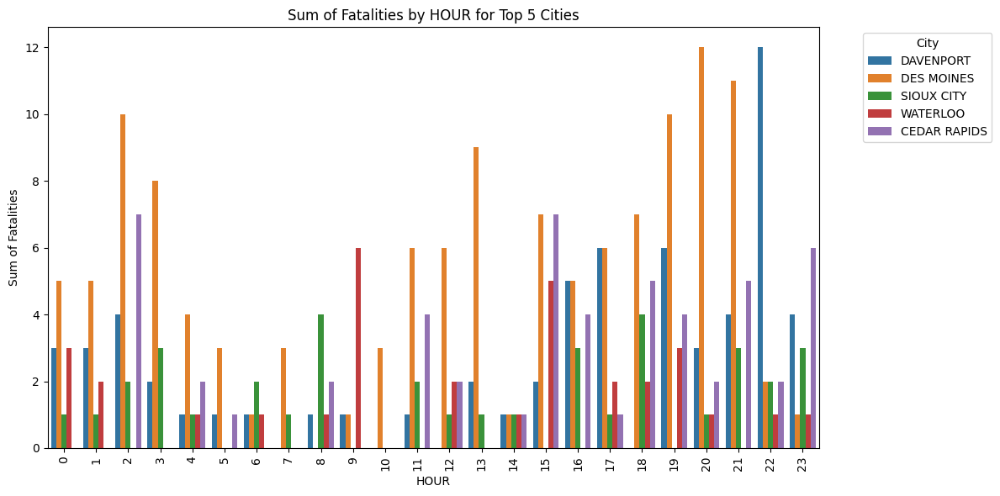

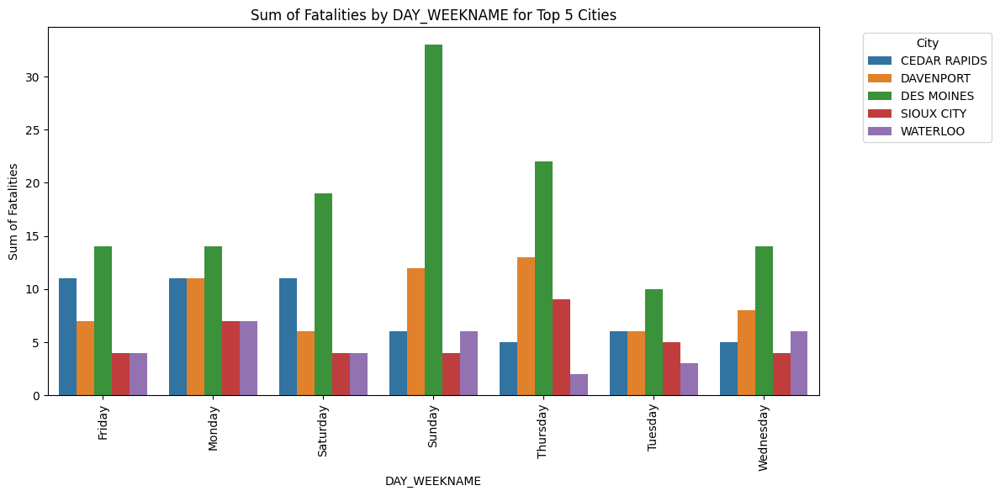

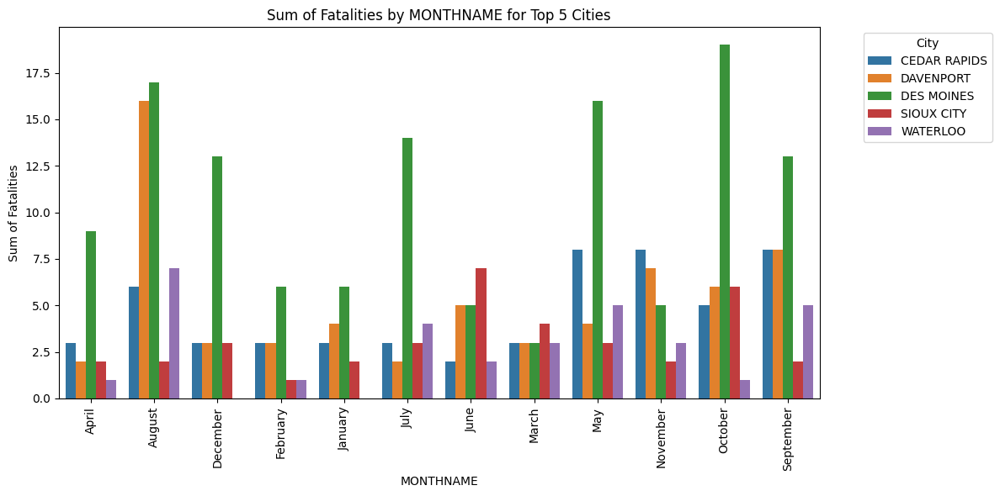

In [223]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure top_5_cities is already computed
top_5_city_names = top_5_cities['CITYNAME'].tolist()  # Get the list of top 5 city names

# Filter the DataFrame for the top 5 cities
filtered_df = iowa_df[iowa_df['CITYNAME'].isin(top_5_city_names)]

# List of variables to plot
grouping_vars = ['WEATHERNAME', 'LGT_CONDNAME', 'HOUR', 'DAY_WEEKNAME', 'MONTHNAME']

# Create a bar plot for each variable
for var in grouping_vars:
    # Group by the selected variable and CITYNAME, summing the fatalities
    fatalities_by_group = (
        filtered_df.groupby([var, 'CITYNAME'])['FATALS']
        .sum()
        .reset_index()
    )
    
    # Set up the matplotlib figure
    plt.figure(figsize=(12, 6))

    # Create the bar plot without error bars
    sns.barplot(
        data=fatalities_by_group, 
        x=var, 
        y='FATALS', 
        hue='CITYNAME', 
        errorbar=('pi', 0)  # Disable error bars
    )

    # Customize the plot
    plt.title(f'Sum of Fatalities by {var} for Top 5 Cities')
    plt.xlabel(var)
    plt.ylabel('Sum of Fatalities')
    plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
    plt.legend(title='City', bbox_to_anchor=(1.05, 1), loc='upper left')  # Move legend to avoid overlap
    plt.tight_layout()

    # Show the plot
    plt.show()


Make a buffer polygon around each line in the polylines of the shapefile.

In [199]:
import geopandas as gpd
from shapely.geometry import Polygon

# Load the JSON file containing multilane arterial roads (polylines)
roads_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/export.geojson')

# Reproject the roads to a projected CRS (e.g., EPSG:3857 - Web Mercator) for accurate buffering in meters
roads_gdf = roads_gdf.to_crs(epsg=3857)

# Create a buffer of 50 meters around each line
roads_gdf['geometry'] = roads_gdf.buffer(50)

# Ensure no overlaps between the polygons (dissolve overlaps if necessary)
# Optionally, if you don't want the polygons to merge:
dissolved_gdf = roads_gdf.dissolve()

# Reproject back to EPSG:4326 (WGS84) after buffering
roads_gdf = roads_gdf.to_crs(epsg=4326)

# Save the result as a shapefile in the same folder
output_path = 'C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/buffered_multilane_roads.shp'
roads_gdf.to_file(output_path, driver='ESRI Shapefile')

print(f"Buffered multilane roads saved to {output_path}")

C:\Users\mrevanth\AppData\Local\Temp\ipykernel_22116\730071924.py:22: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  roads_gdf.to_file(output_path, driver='ESRI Shapefile')


Buffered multilane roads saved to C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/buffered_multilane_roads.shp


Interactive Map of buffer polygons and the Arterial roads.

In [200]:
import geopandas as gpd
import folium

# Load the Iowa state boundary shapefile
iowa_boundary_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/iowa_border/iowa_border.shp')

# Load the original polyline file (multilane arterial roads)
roads_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/export.geojson')

# Load the buffered polygons created earlier
buffered_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/buffered_multilane_roads.shp')

# Reproject all layers to EPSG:4326 for Folium
iowa_boundary_gdf = iowa_boundary_gdf.to_crs(epsg=4326)
roads_gdf = roads_gdf.to_crs(epsg=4326)
buffered_gdf = buffered_gdf.to_crs(epsg=4326)

# Get the bounds of the Iowa boundary (min_x, min_y, max_x, max_y)
bounds = iowa_boundary_gdf.total_bounds

# Calculate the center of the Iowa boundary
center_x = (bounds[0] + bounds[2]) / 2
center_y = (bounds[1] + bounds[3]) / 2

# Create a Folium map centered on the Iowa boundary
interactive_map = folium.Map(location=[center_y, center_x], zoom_start=7)

# Add the Iowa boundary to the map (no fill, black outline)
folium.GeoJson(
    iowa_boundary_gdf.geometry,
    name='Iowa Boundary',
    style_function=lambda x: {'color': 'black', 'weight': 3, 'fillOpacity': 0}
).add_to(interactive_map)

# Add the original multilane arterial roads (polylines) to the map (dark red, thick lines)
folium.GeoJson(
    roads_gdf.geometry,
    name='Multilane Arterial Roads',
    style_function=lambda x: {'color': 'darkred', 'weight': 4}
).add_to(interactive_map)

# Add the buffered polygons to the map (blue fill, no outline)
folium.GeoJson(
    buffered_gdf.geometry,
    name='Buffered Polygons',
    style_function=lambda x: {'color': 'blue', 'weight': 0.5, 'fillOpacity': 0.5, 'fillColor': 'blue'}
).add_to(interactive_map)

# Add layer control to toggle layers
folium.LayerControl().add_to(interactive_map)

# Save the map as HTML and display it
interactive_map.save('multilane_roads_with_buffered_polygons.html')
interactive_map


Static Map of Buffer Polygons.

C:\Users\mrevanth\AppData\Local\Temp\ipykernel_22116\3226864138.py:37: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  boundary_patch = mpatches.Patch(color='none', edgecolor='black', linewidth=2, label='Iowa Boundary')


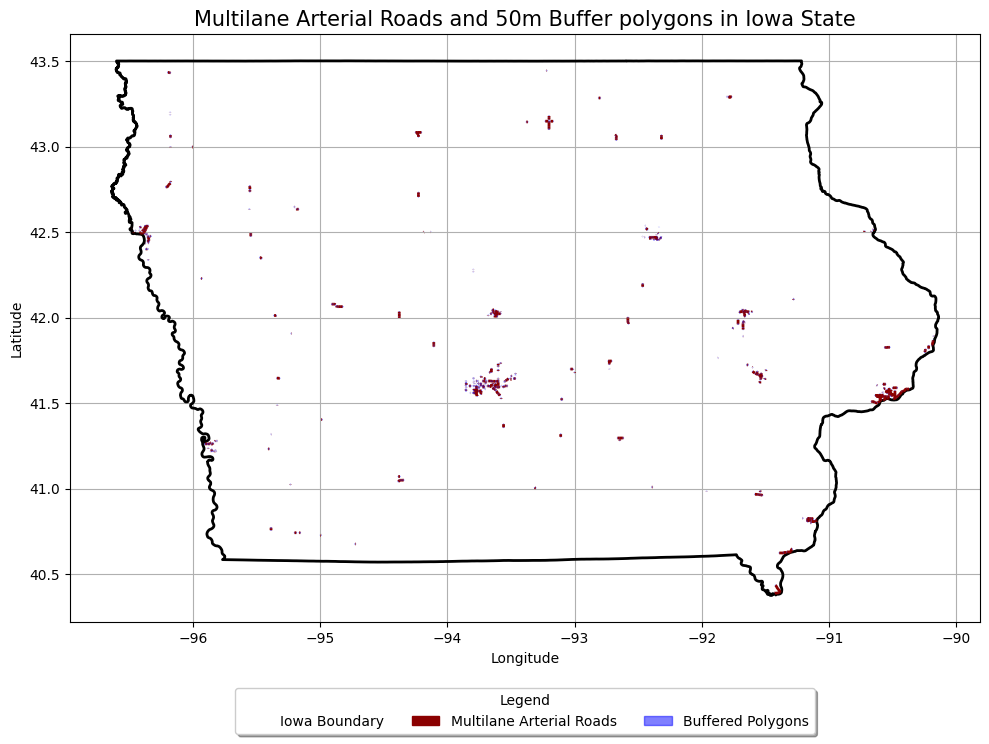

In [201]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# Load the Iowa state boundary shapefile
iowa_boundary_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/iowa_border/iowa_border.shp')

# Load the original polyline file (multilane arterial roads)
roads_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/export.geojson')

# Load the buffered polygons created earlier
buffered_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/buffered_multilane_roads.shp')

# Reproject all layers to EPSG:4326 for consistency
iowa_boundary_gdf = iowa_boundary_gdf.to_crs(epsg=4326)
roads_gdf = roads_gdf.to_crs(epsg=4326)
buffered_gdf = buffered_gdf.to_crs(epsg=4326)

# Create a matplotlib figure and axis
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the buffered polygons first to ensure they are visible and not hidden by other layers
buffered_gdf.plot(ax=ax, color='blue', alpha=0.5, edgecolor='blue', label='Buffered Polygons')

# Plot the Iowa boundary with no fill and black outline
iowa_boundary_gdf.boundary.plot(ax=ax, edgecolor='black', linewidth=2, label='Iowa Boundary')

# Plot the multilane arterial roads in dark red with thick lines
roads_gdf.plot(ax=ax, color='darkred', linewidth=2, label='Multilane Arterial Roads')

# Set plot title and labels
ax.set_title("Multilane Arterial Roads and 50m Buffer polygons in Iowa State", fontsize=15)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# Manually create legend items (matplotlib patches) for each layer to ensure they are included
boundary_patch = mpatches.Patch(color='none', edgecolor='black', linewidth=2, label='Iowa Boundary')
road_patch = mpatches.Patch(color='darkred', label='Multilane Arterial Roads')
buffer_patch = mpatches.Patch(color='blue', alpha=0.5, label='Buffered Polygons')

# Add a legend outside the plot area at the bottom, including all layers
ax.legend(handles=[boundary_patch, road_patch, buffer_patch], loc='upper center', bbox_to_anchor=(0.5, -0.1), fancybox=True, shadow=True, ncol=3, title="Legend")

# Display the plot
plt.grid(True)
plt.tight_layout()
plt.show()


**Code to find the top 3 roads on which maximum fatalities occurred and creating a dataframe of these fatalities.**

In [222]:
import geopandas as gpd

# Load the buffered roads shapefile (if not already loaded in memory)
roads_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/buffered_multilane_roads.shp')

# Ensure both GeoDataFrames have the same CRS
crash_gdf = crash_gdf.to_crs(roads_gdf.crs)

# Perform spatial join to find crashes within the buffered roads
crashes_in_buffers = gpd.sjoin(crash_gdf, roads_gdf, how='inner', predicate='within')

# Summarize the number of fatalities per buffer polygon
fatalities_by_buffer = crashes_in_buffers.groupby('index_right')['FATALS'].sum().reset_index()

# Filter to only show buffers with at least one fatality
fatalities_by_buffer = fatalities_by_buffer[fatalities_by_buffer['FATALS'] > 0]

# Sort buffers by the number of fatalities in descending order
fatalities_by_buffer = fatalities_by_buffer.sort_values(by='FATALS', ascending=False)

# Display results
print(fatalities_by_buffer)

# Optional: Count the number of buffers with at least one crash
buffers_with_crashes = fatalities_by_buffer.shape[0]
print(f"Number of buffers with at least one crash: {buffers_with_crashes}")



############################################################################################################################################



import geopandas as gpd

# Step 1: Load the buffered roads shapefile
roads_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/buffered_multilane_roads.shp')

# Step 2: Ensure both GeoDataFrames (roads and crashes) have the same CRS
crash_gdf = crash_gdf.to_crs(roads_gdf.crs)

# Step 3: Perform spatial join to find crashes within the buffered roads
crashes_in_buffers = gpd.sjoin(crash_gdf, roads_gdf, how='inner', predicate='within')

# Step 4: Summarize the number of fatalities per buffer polygon
fatalities_by_buffer = crashes_in_buffers.groupby('index_right')['FATALS'].sum().reset_index()

# Step 5: Filter and sort buffers by the number of fatalities (descending)
fatalities_by_buffer = fatalities_by_buffer[fatalities_by_buffer['FATALS'] > 0]
fatalities_by_buffer = fatalities_by_buffer.sort_values(by='FATALS', ascending=False)

# Step 6: Extract the top 3 roads with the highest fatal crashes
top_3_roads = fatalities_by_buffer.head(3)
print("Top 3 Roads with the highest fatal crashes:\n", top_3_roads)

# Step 7: Get the road indices for the top 3 roads
top_3_road_indices = top_3_roads['index_right'].tolist()

# Step 8: Extract crash points overlapping the top 3 roads
points_in_top_3_roads = crashes_in_buffers[crashes_in_buffers['index_right'].isin(top_3_road_indices)]

# Step 9: Select the required attributes
selected_attributes = [
    'index_right', 'LATITUDE', 'LONGITUD', 'FATALS', 
    'CITYNAME', 'RD_OWNERNAME', 'LGT_CONDNAME', 
    'WEATHER1NAME', 'DRUNK_DR'
]

# Ensure all required columns are available
if all(attr in points_in_top_3_roads.columns for attr in selected_attributes):
    points_in_top_3_roads = points_in_top_3_roads[selected_attributes]
else:
    missing_attrs = [attr for attr in selected_attributes if attr not in points_in_top_3_roads.columns]
    raise ValueError(f"Missing required attributes: {missing_attrs}")

# Step 10: Add the road rank based on the fatalities
top_3_roads = top_3_roads.reset_index(drop=True)  # Reset index to use for ranking
rank_mapping = {row['index_right']: idx + 1 for idx, row in top_3_roads.iterrows()}
points_in_top_3_roads['Road_Rank'] = points_in_top_3_roads['index_right'].map(rank_mapping)

# Step 11: Display the results
print("Points overlapping the top 3 roads with their attributes and rank:\n", points_in_top_3_roads)

# Optional: Save the results to a CSV file
points_in_top_3_roads.to_csv('top_3_road_crashes.csv', index=False)


    index_right  FATALS
58          734       3
18          118       3
11           82       2
34          332       2
35          345       2
..          ...     ...
33          317       1
32          314       1
31          291       1
30          276       1
90         1297       1

[91 rows x 2 columns]
Number of buffers with at least one crash: 91
Top 3 Roads with the highest fatal crashes:
     index_right  FATALS
58          734       3
18          118       3
11           82       2
Points overlapping the top 3 roads with their attributes and rank:
         index_right   LATITUDE   LONGITUD  FATALS    CITYNAME  \
188154          734  41.605472 -93.736250       3       CLIVE   
188206          118  41.607731 -93.600544       2  DES MOINES   
188263           82  41.538219 -90.598175       1   DAVENPORT   
188365          118  41.613231 -93.600603       1  DES MOINES   
188374           82  41.538258 -90.585542       1   DAVENPORT   

                            RD_OWNERNAME   

**Result**: 

Top 3 roads on which the accidents occurred are in Clive, Des Moines and Davenport with ranks 1,2 and 3 respectively based on the fatality count. Most of these crashes occurred during daylight but one crash with 3 fatals occurred during dark conditions with lighting. Further analysis require more years of data.

Code to plot Buffer polygons and the crashes.

In [97]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster

# Convert crash points (iowa_gdf), buffer polygons (buffered_gdf), and Iowa boundary to GeoJSON format for folium
# Ensure all GeoDataFrames are in EPSG:4326 (WGS84)
iowa_gdf = iowa_gdf.to_crs(epsg=4326)
buffered_gdf = buffered_gdf.to_crs(epsg=4326)

# Load the Iowa state boundary shapefile and ensure it's in EPSG:4326
iowa_boundary_gdf = gpd.read_file('C:/Users/mrevanth/OneDrive - Iowa State University/Desktop/Miniproject 1/iowa_border/iowa_border.shp')
iowa_boundary_gdf = iowa_boundary_gdf.to_crs(epsg=4326)

# Create a Folium map centered on the area of the Iowa boundary or buffers
# Calculate center of the buffer polygons to use as map center
bounds = buffered_gdf.total_bounds
center_lat = (bounds[1] + bounds[3]) / 2  # Average latitude
center_long = (bounds[0] + bounds[2]) / 2  # Average longitude

# Initialize the folium map
interactive_map = folium.Map(location=[center_lat, center_long], zoom_start=8)

# Add the Iowa state boundary with a black outline and no fill
folium.GeoJson(
    iowa_boundary_gdf.geometry,
    name='Iowa Boundary',
    style_function=lambda x: {'color': 'black', 'weight': 3, 'fillOpacity': 0}
).add_to(interactive_map)

# Add the buffer polygons with blue fill
folium.GeoJson(
    buffered_gdf.geometry,
    name='Buffer Polygons',
    style_function=lambda x: {'color': 'blue', 'weight': 0.5, 'fillColor': 'blue', 'fillOpacity': 0.5}
).add_to(interactive_map)

# Create a MarkerCluster to group crash points together
marker_cluster = MarkerCluster().add_to(interactive_map)

# Add the crash points to the marker cluster
for idx, crash in iowa_gdf.iterrows():
    folium.Marker([crash.geometry.y, crash.geometry.x], 
                  popup=f"Crash at ({crash.geometry.y}, {crash.geometry.x})").add_to(marker_cluster)

# Add layer control to allow toggling of layers
folium.LayerControl().add_to(interactive_map)

# Save and display the map
interactive_map.save('crash_hotspot_map_with_boundary.html')
interactive_map


## Crashes analysis

**Plot depicting the annual crash count and fatalities occurred in Iowa.**

Crashes and Fatalities per Year in Iowa:
    YEAR  Total_Crashes  Total_Fatalities
0  2016            355               402
1  2017            301               330
2  2018            291               319
3  2019            313               336
4  2020            310               343
5  2021            329               356
6  2022            307               338


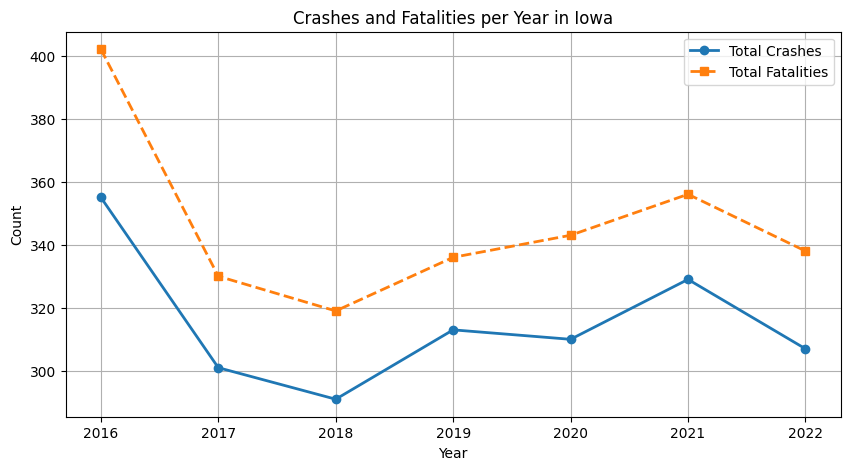

In [221]:
import pandas as pd

def calculate_crashes_and_fatalities(iowa_df):
    # Ensure the required columns are present
    required_columns = {'YEAR', 'FATALS'}
    if not required_columns.issubset(iowa_df.columns):
        raise ValueError(f"Missing required columns: {required_columns}")

    # Step 1: Group by 'YEAR' and calculate the total crashes and fatalities
    summary_table = iowa_df.groupby('YEAR').agg(
        Total_Crashes=('YEAR', 'count'),  # Count of crashes (number of rows)
        Total_Fatalities=('FATALS', 'sum')  # Sum of fatalities
    ).reset_index()

    # Step 2: Display the table
    print("Crashes and Fatalities per Year in Iowa:\n", summary_table)

    return summary_table

# Example usage (assuming iowa_df is already loaded)
crashes_fatalities_table = calculate_crashes_and_fatalities(iowa_df)

# Optional: Save the summary table to a CSV file
crashes_fatalities_table.to_csv('iowa_crashes_fatalities_per_year.csv', index=False)


################################################################################################################################


import pandas as pd
import matplotlib.pyplot as plt

def calculate_crashes_and_fatalities(iowa_df):
    # Ensure the required columns are present
    required_columns = {'YEAR', 'FATALS'}
    if not required_columns.issubset(iowa_df.columns):
        raise ValueError(f"Missing required columns: {required_columns}")

    # Step 1: Group by 'YEAR' and calculate the total crashes and fatalities
    summary_table = iowa_df.groupby('YEAR').agg(
        Total_Crashes=('YEAR', 'count'),  # Count of crashes (number of rows)
        Total_Fatalities=('FATALS', 'sum')  # Sum of fatalities
    ).reset_index()

    return summary_table

def plot_crashes_and_fatalities(summary_table):
    # Plotting the crashes and fatalities on the same graph
    plt.figure(figsize=(10, 5))

    # Plot Total Crashes
    plt.plot(summary_table['YEAR'], summary_table['Total_Crashes'], 
             marker='o', linestyle='-', linewidth=2, label='Total Crashes')

    # Plot Total Fatalities
    plt.plot(summary_table['YEAR'], summary_table['Total_Fatalities'], 
             marker='s', linestyle='--', linewidth=2, label='Total Fatalities')

    # Adding labels, title, and legend
    plt.xlabel('Year')
    plt.ylabel('Count')
    plt.title('Crashes and Fatalities per Year in Iowa')
    plt.legend()
    plt.grid(True)

    # Display the plot
    plt.show()


# Calculate the summary table and plot the data
summary_table = calculate_crashes_and_fatalities(iowa_df)
plot_crashes_and_fatalities(summary_table)

Data analysis for top 5 cities.

In [211]:
import pandas as pd

def calculate_crashes_and_fatalities(iowa_df):
    # Ensure required columns are available
    required_columns = {'YEAR', 'FATALS', 'CITYNAME'}
    if not required_columns.issubset(iowa_df.columns):
        raise ValueError(f"Missing required columns: {required_columns}")

    # Step 1: Group by YEAR to calculate total crashes and fatalities for each year
    yearly_summary = iowa_df.groupby('YEAR').agg(
        Total_Crashes=('YEAR', 'count'),  # Number of crashes per year
        Total_Fatalities=('FATALS', 'sum')  # Total fatalities per year
    ).reset_index()

    print("Yearly Crash and Fatality Summary:\n", yearly_summary)

    # Step 2: Group by CITYNAME to get crash count and fatalities for each city
    crash_count_per_city = iowa_df.groupby('CITYNAME').size()
    fatalities_per_city = iowa_df.groupby('CITYNAME')['FATALS'].sum()

    # Create a DataFrame with city-level statistics
    city_summary = pd.DataFrame({
        'Crash_Count': crash_count_per_city,
        'Number_of_Fatalities': fatalities_per_city
    }).reset_index()

    # Filter out 'NOT APPLICABLE' cities
    city_summary = city_summary[city_summary['CITYNAME'] != 'NOT APPLICABLE']

    # Step 3: Get the top 5 cities with the highest number of crashes
    top_5_cities = city_summary.sort_values(by='Crash_Count', ascending=False).head(5)

    print("\nTop 5 Cities with the Most Crashes:\n", top_5_cities)

    # Step 4: Merge the yearly summary with the top 5 cities data for each year
    top_5_city_crashes = iowa_df[iowa_df['CITYNAME'].isin(top_5_cities['CITYNAME'])]
    yearly_city_summary = top_5_city_crashes.groupby(['YEAR', 'CITYNAME']).agg(
        City_Crash_Count=('YEAR', 'count'),
        City_Fatalities=('FATALS', 'sum')
    ).reset_index()

    print("\nYearly Crash and Fatality Summary for Top 5 Cities:\n", yearly_city_summary)

    # Step 5: Merge the yearly and top 5 city summaries into one table (optional)
    merged_summary = pd.merge(yearly_summary, yearly_city_summary, on='YEAR', how='left')

    # Display the merged summary
    print("\nMerged Yearly Summary with Top 5 Cities:\n", merged_summary)

    return yearly_summary, top_5_cities, yearly_city_summary

# Example usage (assuming iowa_df is already loaded)
yearly_summary, top_5_cities, yearly_city_summary = calculate_crashes_and_fatalities(iowa_df)

# Optional: Save the results to CSV files
yearly_summary.to_csv('iowa_yearly_crashes.csv', index=False)
top_5_cities.to_csv('top_5_cities_crashes.csv', index=False)
#yearly_city_summary.to_csv('yearly_top_5_city_crashes.csv', index=False)


Yearly Crash and Fatality Summary:
    YEAR  Total_Crashes  Total_Fatalities
0  2016            355               402
1  2017            301               330
2  2018            291               319
3  2019            313               336
4  2020            310               343
5  2021            329               356
6  2022            307               338

Top 5 Cities with the Most Crashes:
          CITYNAME  Crash_Count  Number_of_Fatalities
40     DES MOINES          115                   126
36      DAVENPORT           58                    63
22   CEDAR RAPIDS           51                    55
138    SIOUX CITY           34                    37
150      WATERLOO           29                    32

Yearly Crash and Fatality Summary for Top 5 Cities:
     YEAR      CITYNAME  City_Crash_Count  City_Fatalities
0   2016  CEDAR RAPIDS                 8                9
1   2016     DAVENPORT                 7                7
2   2016    DES MOINES                19            

# Predictive Ramdom Forest Model

With all variables.

Mean Squared Error: 0.15481646525679757
Top 20 Feature Importances:
                                    Feature  Importance
7                                   PERMVIT    0.081313
6                                   PERSONS    0.066386
1                                   ST_CASE    0.060553
22                                   MILEPT    0.053569
9                                    COUNTY    0.048387
16                                   MINUTE    0.048262
37                                  NOT_MIN    0.046616
122  HARM_EVNAME_Utility Pole/Light Support    0.040137
13                                    MONTH    0.035594
11                                      DAY    0.030847
12                                  DAYNAME    0.030614
41                                  HOSP_MN    0.028700
14                                     YEAR    0.027653
40                                  HOSP_HR    0.027472
45                                 DRUNK_DR    0.027457
25                                 M

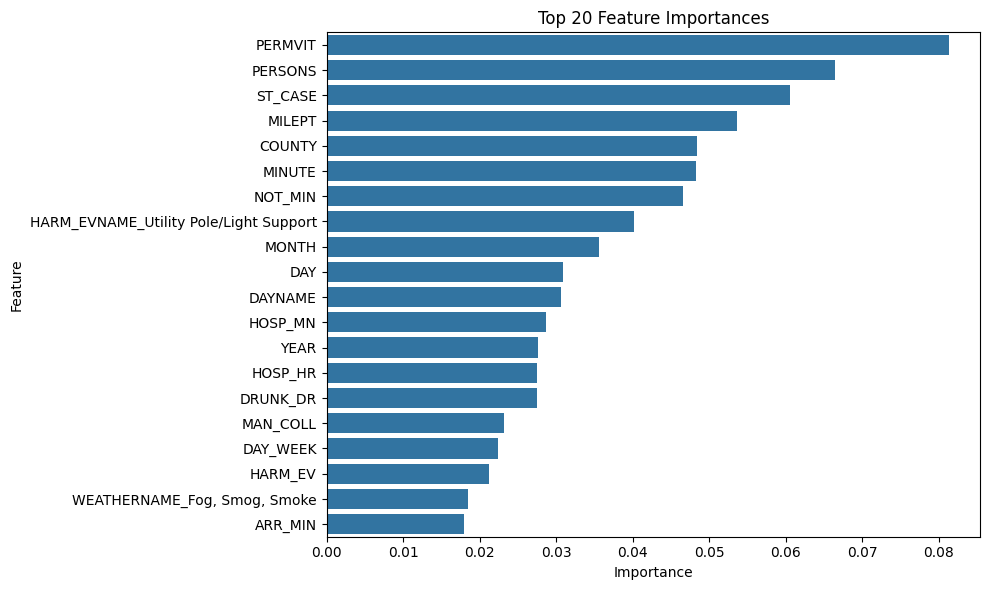

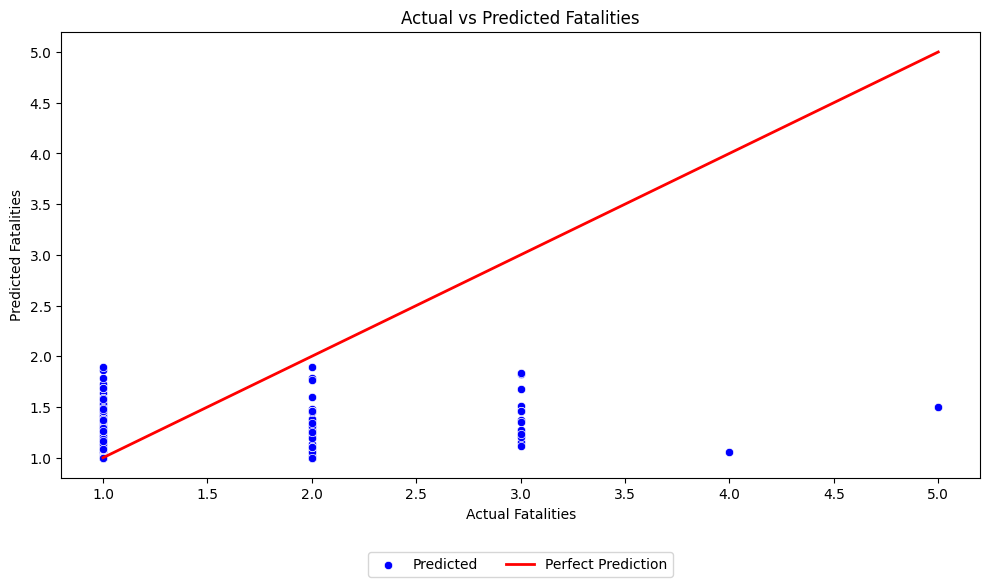

In [120]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns

# Select numerical columns from the DataFrame
numerical_columns = iowa_df.select_dtypes(include='number').columns.tolist()

# Append any categorical variables you want to include
categorical_features = ['WEATHERNAME', 'LGT_CONDNAME', 'TYP_INTNAME', 'DAY_WEEKNAME', 'HARM_EVNAME']
features = numerical_columns + categorical_features

# Target variable
target = 'FATALS'

# Create a DataFrame with features only (without the target)
X = iowa_df[features]

# Drop irrelevant columns
X = X.drop(['FATALS', 'LONGITUD', 'LATITUDE', 'HOUR'], axis=1)

# Convert categorical variables to numerical format (one-hot encoding)
X_encoded = pd.get_dummies(X, drop_first=True)

# Create the target variable
y = iowa_df[target]

# Split the data into training (70%) and test sets (30%)
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.3, random_state=42)

# Initialize and train the Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf_model.predict(X_test)

# Evaluate the model using Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")

# Get feature importances
importances = rf_model.feature_importances_
feature_names = X_encoded.columns
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})

# Sort and display top 20 feature importances
top_features = feature_importance_df.sort_values(by='Importance', ascending=False).head(20)
print("Top 20 Feature Importances:")
print(top_features)

# Plot the top 20 feature importances
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=top_features)
plt.title('Top 20 Feature Importances')
plt.tight_layout()
plt.show()

# Plot actual vs predicted fatalities to visualize fitting
plt.figure(figsize=(10, 6))

# Scatter plot of actual vs predicted values
sns.scatterplot(x=y_test, y=y_pred, color='blue', label='Predicted')

# Plot a line representing the perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, label='Perfect Prediction')

# Add labels and title
plt.xlabel('Actual Fatalities')
plt.ylabel('Predicted Fatalities')
plt.title('Actual vs Predicted Fatalities')

# Move the legend to the bottom of the plot
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2)

# Display the plot
plt.tight_layout()
plt.show()

## Random Forest Model With Selected Variables.

The variables are 'CITYNAME', 'MONTH', 'YEAR', 'DAY_WEEK', 'HOUR', 'LGT_CONDNAME', 'WEATHERNAME', 'DRUNK_DR'.

Mean Squared Error: 0.20153722633434037
R² Score: -0.12031762012337666
Top 20 Feature Importances:
        Feature  Importance
4          HOUR    0.242170
1         MONTH    0.200246
2          YEAR    0.134779
3      DAY_WEEK    0.133332
0      CITYNAME    0.100615
6   WEATHERNAME    0.090532
5  LGT_CONDNAME    0.060520
7      DRUNK_DR    0.037808


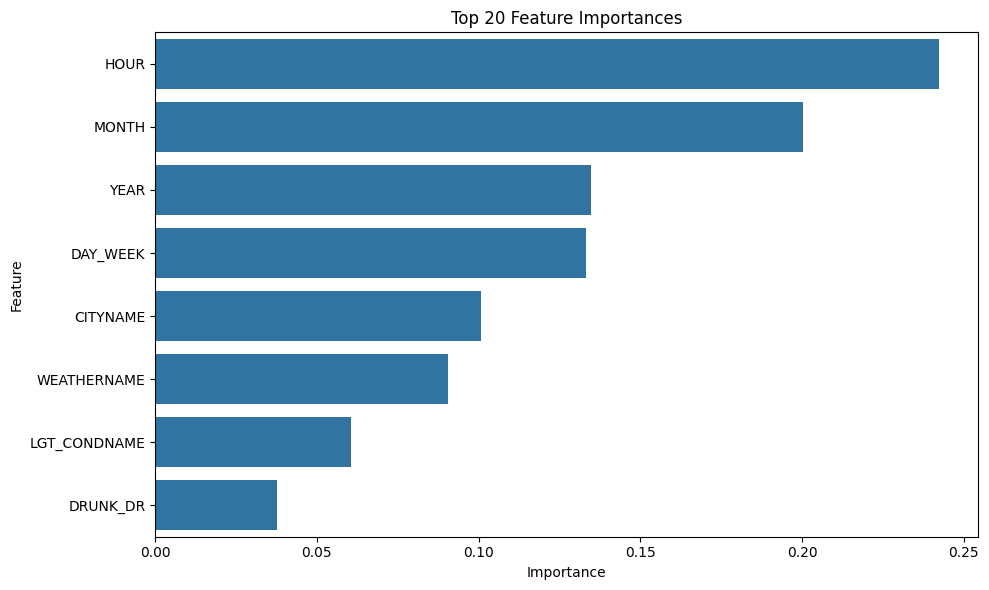

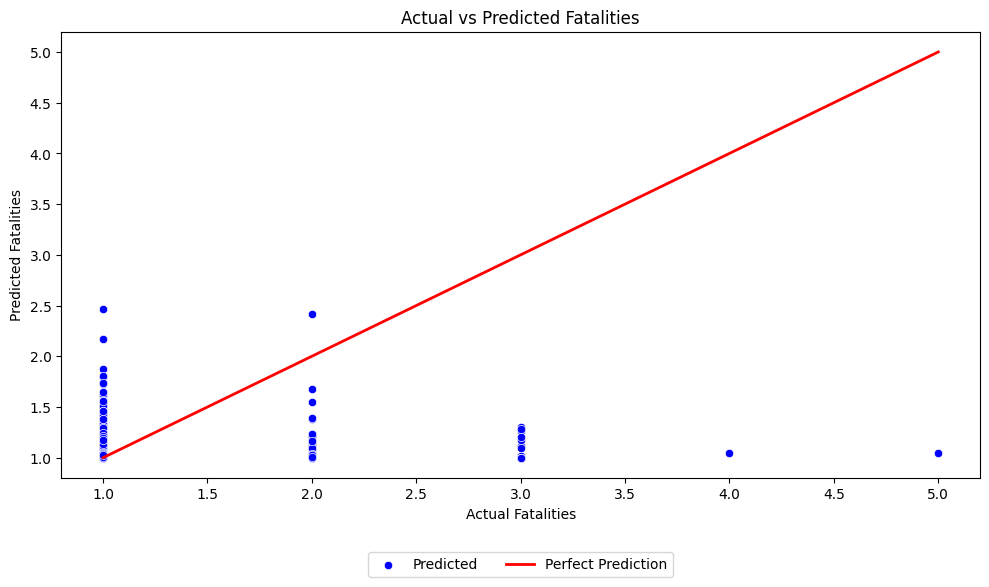

In [220]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder

# Select relevant features and target variable
selected_features = ['CITYNAME', 'MONTH', 'YEAR', 'DAY_WEEK', 'HOUR', 
                     'LGT_CONDNAME', 'WEATHERNAME', 'DRUNK_DR']
target = 'FATALS'

# Create a copy of the feature DataFrame and target variable to avoid warnings
X = iowa_df[selected_features].copy()
y = iowa_df[target].copy()

# Handle missing values using .loc to modify the DataFrame safely
X.loc[:, 'DRUNK_DR'] = X['DRUNK_DR'].fillna(0)

# Apply Label Encoding to categorical variables
categorical_cols = ['CITYNAME', 'LGT_CONDNAME', 'WEATHERNAME']
label_encoders = {}  # Store encoders for each categorical column

for col in categorical_cols:
    le = LabelEncoder()
    # Use .loc to modify columns safely and avoid warnings
    X.loc[:, col] = le.fit_transform(X[col].astype(str))
    label_encoders[col] = le  # Save the encoder for future use

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize and train the Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf_model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R² Score: {r2}")

# Get and display feature importances
importances = rf_model.feature_importances_
feature_names = X.columns
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})

# Sort and display top features
top_features = feature_importance_df.sort_values(by='Importance', ascending=False).head(20)
print("Top 20 Feature Importances:")
print(top_features)

# Plot the top 20 feature importances
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=top_features)
plt.title('Top 20 Feature Importances')
plt.tight_layout()
plt.show()

# Plot actual vs predicted fatalities
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=y_pred, color='blue', label='Predicted')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, label='Perfect Prediction')
plt.xlabel('Actual Fatalities')
plt.ylabel('Predicted Fatalities')
plt.title('Actual vs Predicted Fatalities')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2)
plt.tight_layout()
plt.show()
